# Latent Diffusion Bridges for Unsupervised Timbre Transfer Demo
This demo page is for the paper Latent Diffusion Bridges for Unsupervised Timbre Transfer


Source code: link

## Table of Contents

1. [Timbre Transfer Results](#timbre-transfer-results)  
   1.1. [Normal Instruments Created with Our Method](#normal-instruments-created-with-our-method)  
   1.2. [Pitch-Shifted Flute](#pitch-shifted-flute)  
   1.3. [Chunk-Based Minibatch](#chunk-based-minibatch)  

2. [Impact of Different Sigma Max and Sigma N](#impact-of-different-sigma-max-and-sigma-n)  

3. [Shared Space and Cycle Consistency](#shared-space-and-cycle-consistency)  
   3.1. [Similar Melodies Examples](#similar-melodies-examples)  
   3.2. [Cycle Consistency Graph](#cycle-consistency-graph)  



<a id="timbre-transfer-results"></a>

## Timbre Transfer Results




<a id="normal-instruments-created-with-our-method"></a>

### Normal Instruments Created with Our Method



In [7]:
import warnings
warnings.filterwarnings('ignore')

import sys
sys.path.append('/mnt/beegfs/group/mt/yurii/tssb')
from eval_scripts.config import (
    real_data_base_path,
    output_path
)
import os
from notebooks.utils import *
from audio_diffusion_pytorch import NormalizedEncodec, PitchTracker
pitch_tracker = PitchTracker()

from IPython.display import display, HTML, Audio, Markdown
import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np

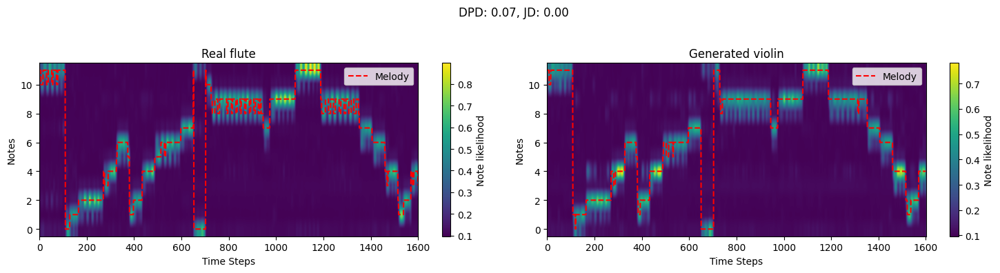

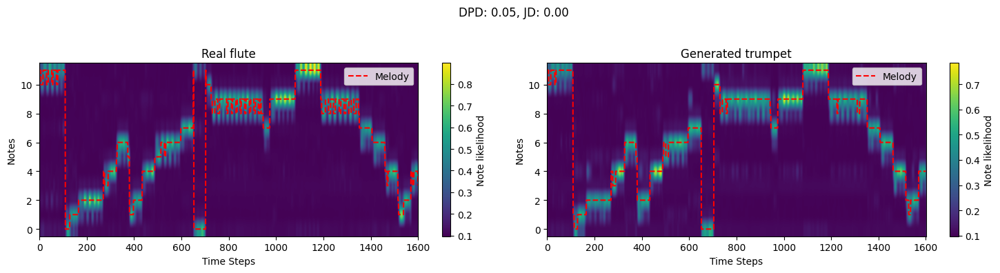

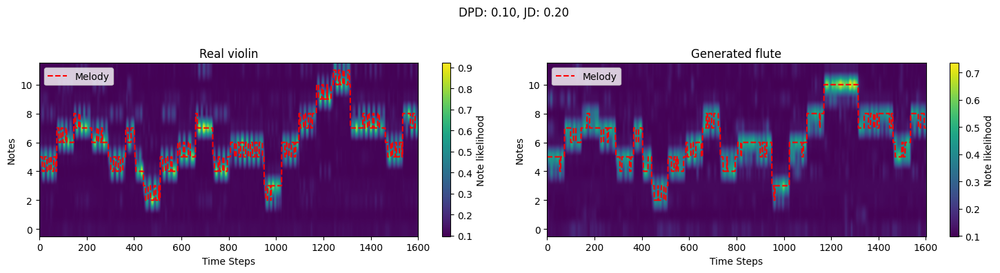

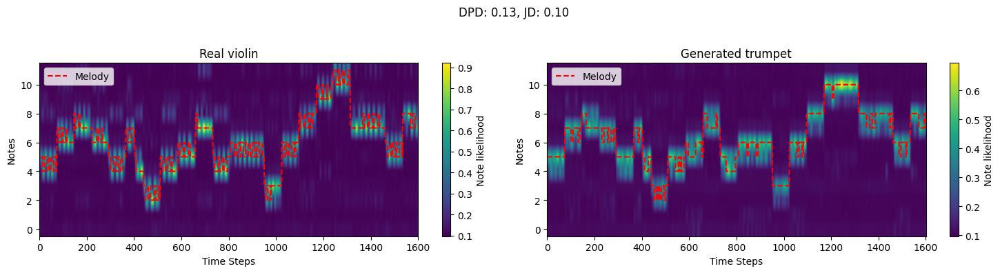

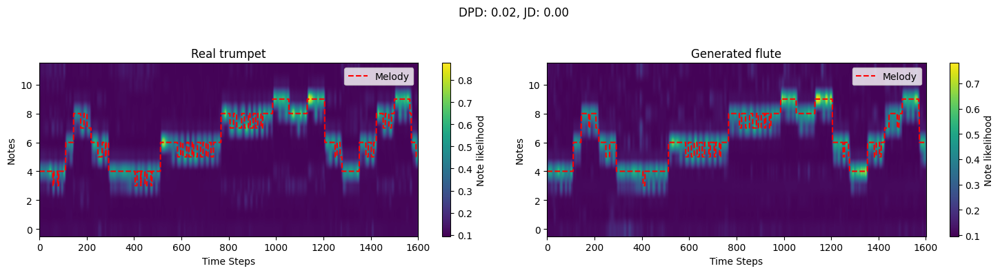

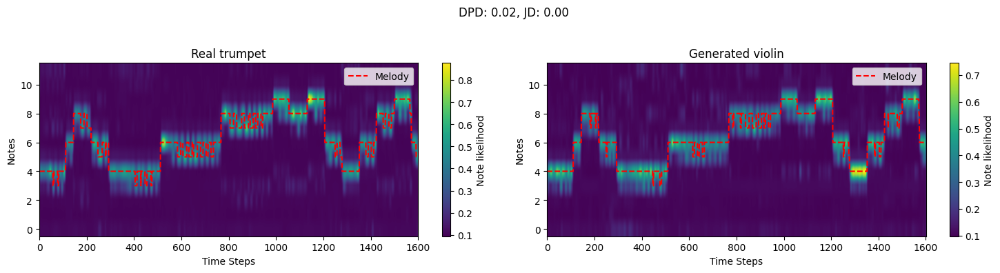

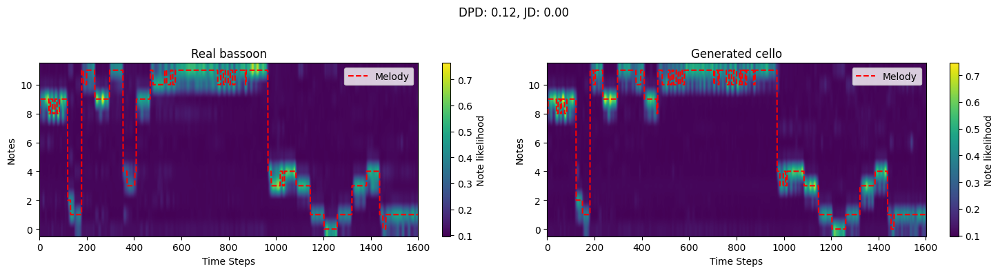

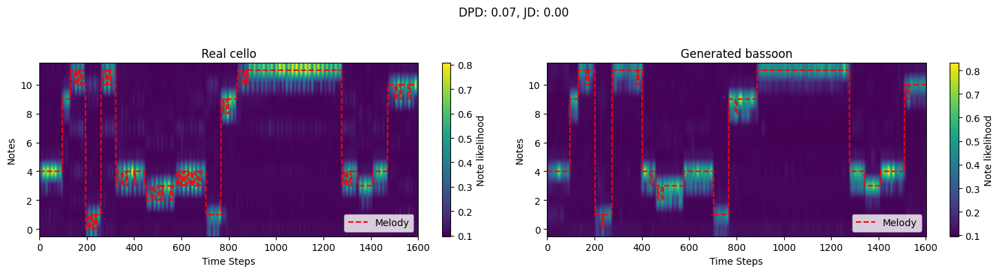

In [2]:
pairs_to_show = [ 
    ('flute', 'violin'),
    ('flute', 'trumpet'),
    ('violin', 'flute'),
    ('violin', 'trumpet'),
    ('trumpet', 'flute'),
    ('trumpet', 'violin'),
    ('bassoon', 'cello'),
    ('cello', 'bassoon')
]

exp_names = [
    'flute_to_violin_s5',
    'flute_to_trumpet',
    'violin_to_flute_s5',
    'violin_to_trumpet',
    'trumpet_to_flute',
    'trumpet_to_violin',
    'bassoon_to_cello',
    'cello_to_bassoon'

]

indx_to_show = [0,0,0,0,1,1,2,8]

sr=24000

for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair

    html_text = f"""
    <div style="margin-left: 0px; font-size: 18px;">
        {source_instrument} -> {target_instrument}
    </div>
    """
    display(HTML(html_text))


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()
    combined_audio_html = f"""
        <div style="display: flex; justify-content: flex-start;">
            <div style="margin-right: 10px;">{audio_html_real}</div>
            <div>{audio_html_generated}</div>
    </div>
    """
    display(HTML(combined_audio_html))


    dtw, jaccard = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=(source_instrument, target_instrument))[0]

<a id="pitch-shifted-flute"></a>

### Pitch-Shifted



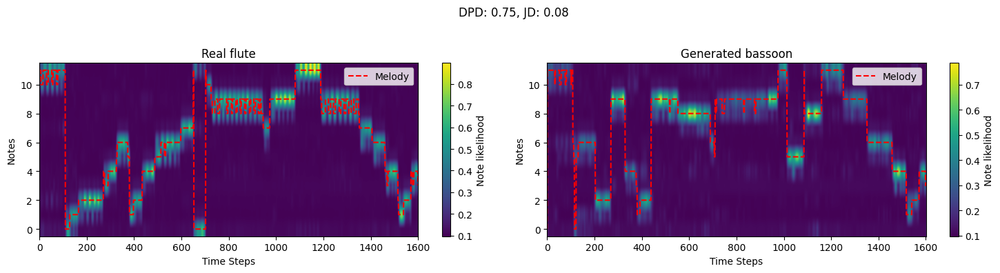

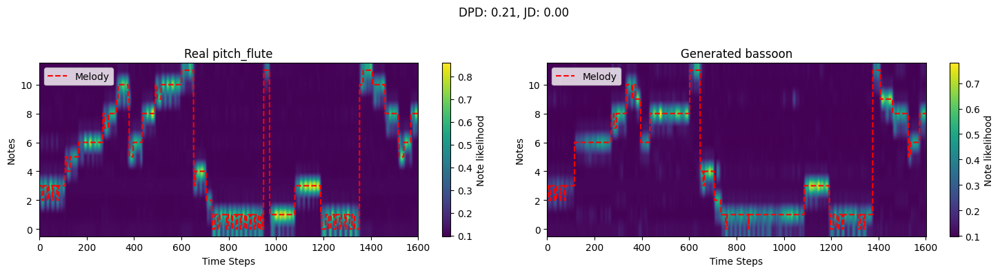

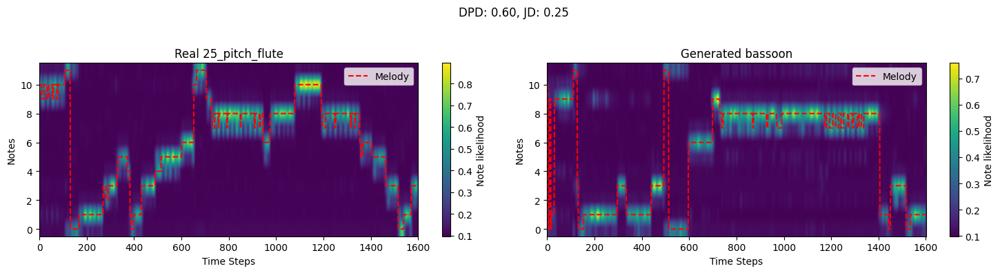

In [4]:
pairs_to_show = [ 
    ('flute', 'bassoon'),
    ('pitch_flute', 'bassoon'),
    ('25_pitch_flute', 'bassoon'),
]

exp_names = [
    'flute_to_bassoon_trained_s5_inference_s5',
    'pitch_flute_to_bassoon',
    'pitch_flute_to_bassoon_s5'
]

#indx_to_show = np.zeros(len(pairs_to_show), dtype=int)

indx_to_show = [0,0,0]

sr=24000


for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair
    if source_instrument == 'pitch_flute':
        source_instrument_plot = 'flute shifted -20 semitones'
    elif source_instrument == '25_pitch_flute':
        source_instrument_plot = 'flute shifted -25 semitones'
    else:
        source_instrument_plot = source_instrument

    html_text = f"""
    <div style="margin-left: 0px; font-size: 18px;">
        {source_instrument_plot} -> {target_instrument}
    </div>
    """
    display(HTML(html_text))


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()
    combined_audio_html = f"""
        <div style="display: flex; justify-content: flex-start;">
            <div style="margin-right: 10px;">{audio_html_real}</div>
            <div>{audio_html_generated}</div>
    </div>
    """
    display(HTML(combined_audio_html))


    dtw, jaccard = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=(source_instrument, target_instrument))[0]

<a id="chunk-based-minibatch"></a>

### Chunk-Based Minibatch



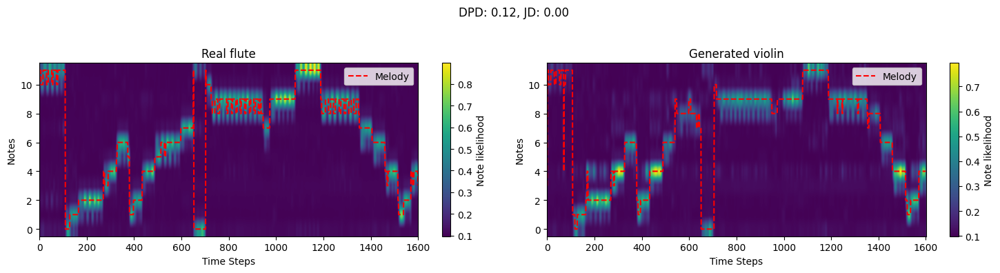

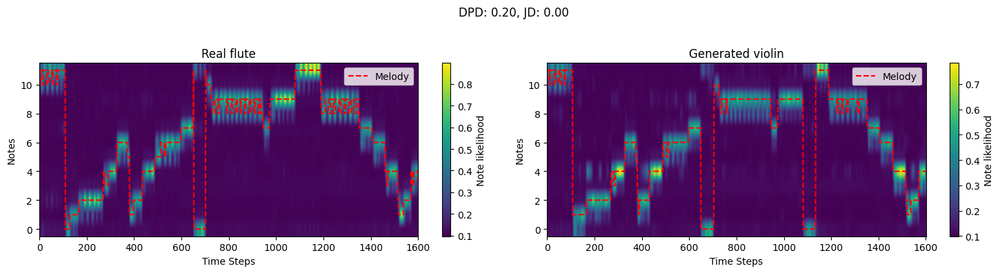

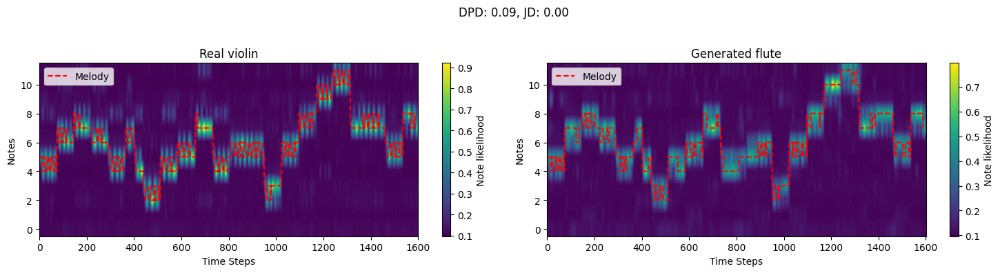

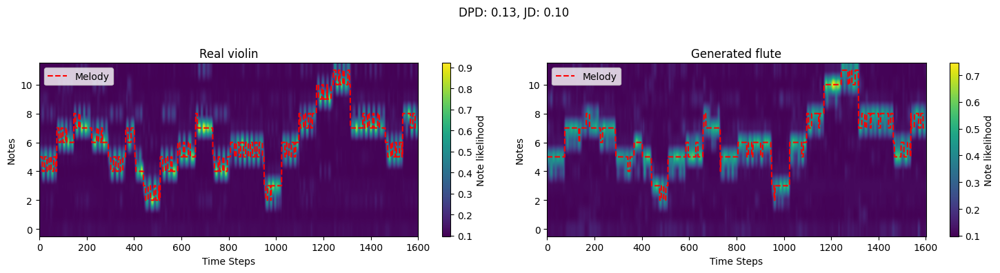

In [6]:
pairs_to_show = [ 
    ('flute', 'violin'),
    ('flute', 'violin'),
    ('violin', 'flute'),
    ('violin', 'flute')
]

exp_names = [
    'flute_to_violin_s100_time_chunk',
    'flute_to_violin_s100_time_channel_chunk',
    'violin_to_flute_s100_time_chunk',
    'violin_to_flute_s100_time_channel_chunk',
]

#indx_to_show = np.zeros(len(pairs_to_show), dtype=int)

indx_to_show = [0,0,0,0]

sr=24000


for exp_name, pair, indx in zip(exp_names, pairs_to_show, indx_to_show):
    source_instrument, target_instrument = pair
    if exp_name == 'flute_to_violin_s100_time_chunk':
        descr = 'flute -> violin with time chunk size 4 and channel chunk size 0'
    elif exp_name == 'flute_to_violin_s100_time_channel_chunk':
        descr = 'flute -> violin with time chunk size 4 and channel chunk size 32'
    elif exp_name == 'violin_to_flute_s100_time_chunk':
        descr = 'violin -> flute with time chunk size 4 and channel chunk size 0'
    elif exp_name == 'violin_to_flute_s100_time_channel_chunk':
        descr = 'violin -> flute with time chunk size 4 and channel chunk size 32'
    else:
        descr = f'{source_instrument} -> {target_instrument}'

    html_text = f"""
    <div style="margin-left: 0px; font-size: 18px;">
        {descr}
    </div>
    """
    display(HTML(html_text))


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()
    combined_audio_html = f"""
        <div style="display: flex; justify-content: flex-start;">
            <div style="margin-right: 10px;">{audio_html_real}</div>
            <div>{audio_html_generated}</div>
    </div>
    """
    display(HTML(combined_audio_html))


    dtw, jaccard = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=(source_instrument, target_instrument))[0]

<a id="impact-of-different-sigma-max-and-sigma-n"></a>

## Impact of Different Sigma Max and Sigma N



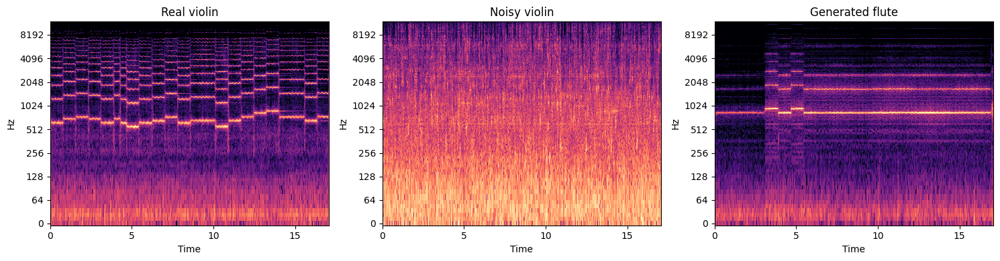

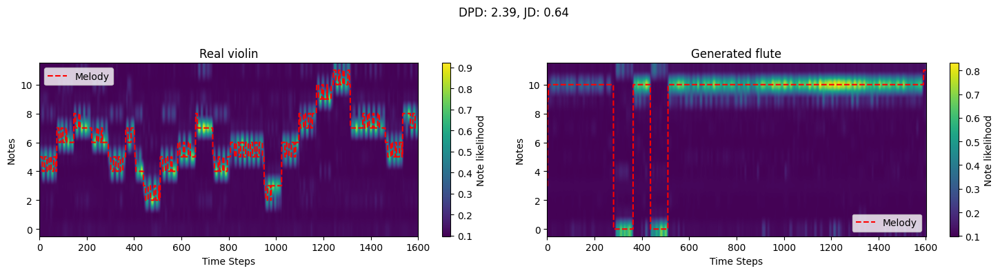

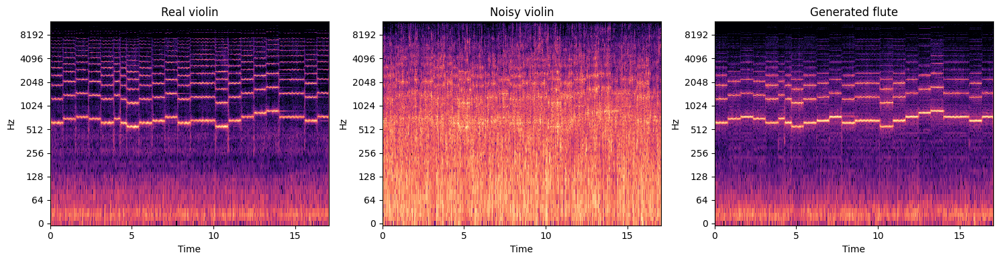

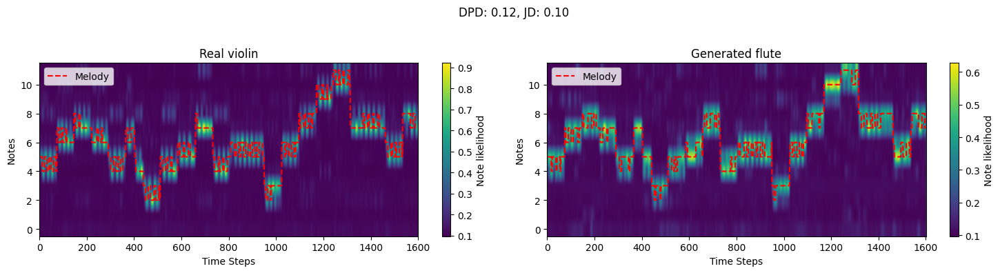

In [9]:
pairs_to_show = [ 
    ('violin', 'flute'),
    ('violin', 'flute')
]

exp_names = [
    'violin_to_flute_s100_old_shared_space',
    'violin_to_flute_s100_old',
]

noises_names = [
    'violin_to_flute_noises_s100',
    'violin_to_flute_noises_s5'
]

#indx_to_show = np.zeros(len(pairs_to_show), dtype=int)

indx_to_show = [0,0]

sr=24000

for exp_name, pair, indx, noise_name in zip(exp_names, pairs_to_show, indx_to_show, noises_names):
    source_instrument, target_instrument = pair
    if exp_name == 'violin_to_flute_s100_old_shared_space':
        descr = 'violin -> noise -> flute (with sigma_N=100)'
    elif exp_name == 'violin_to_flute_noises_s5':
        descr = 'violin -> noise -> flute (with sigma_N=5)'
    else:
        descr = f'{source_instrument} -> {target_instrument}'

    html_text = f"""
    <div style="margin-left: 0px; font-size: 18px;">
        {descr}
    </div>
    """
    display(HTML(html_text))


    source_instrument_path = os.path.join(real_data_base_path, source_instrument)
    source_file_names = os.listdir(source_instrument_path)
    source_file_names.sort()
    source_file_names = [f for f in source_file_names if os.path.isfile(os.path.join(source_instrument_path, f))]

    # Get real audio
    source_real_audio_path = os.path.join(source_instrument_path, source_file_names[indx])
    source_real_audio = load_resample_prepare_audio(source_real_audio_path, sr)

    # Get generated audio
    source_generated_audio_path = os.path.join(output_path, exp_name, 'audios', f'{indx}.wav')
    source_generated_audio = load_resample_prepare_audio(source_generated_audio_path, sr)

    # Get noises
    source_generated_noise_path = os.path.join(output_path, noise_name, 'audios', f'{indx}.wav')
    source_generated_noise = load_resample_prepare_audio(source_generated_noise_path, sr)

    audio_html_real = Audio(undo_prepare_audio(source_real_audio), rate=sr)._repr_html_()
    noise_html = Audio(undo_prepare_audio(source_generated_noise), rate=sr)._repr_html_()
    audio_html_generated = Audio(undo_prepare_audio(source_generated_audio), rate=sr)._repr_html_()
    combined_audio_html = f"""
        <div style="display: flex; justify-content: flex-start;">
            <div style="margin-right: 10px;">{audio_html_real}</div>
            <div>{noise_html}</div>
            <div>{audio_html_generated}</div>
    </div>
    """
    display(HTML(combined_audio_html))


    # Create a figure with a specific size
    fig, axs = plt.subplots(1, 3, figsize=(15, 4))

    # Plot the spectrogram for the real audio
    axs[0].set_title(f"Real {source_instrument}")
    D_real = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_real_audio)[0])), ref=np.max)
    librosa.display.specshow(D_real, sr=sr, x_axis='time', y_axis='log', ax=axs[0])

    # Plot the spectrogram for the generated noise
    axs[1].set_title(f"Noisy {source_instrument}")
    D_noise = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_generated_noise)[0])), ref=np.max)
    librosa.display.specshow(D_noise, sr=sr, x_axis='time', y_axis='log', ax=axs[1])

    # Plot the spectrogram for the generated audio
    axs[2].set_title(f"Generated {target_instrument}")
    D_generated = librosa.amplitude_to_db(np.abs(librosa.stft(undo_prepare_audio(source_generated_audio)[0])), ref=np.max)
    librosa.display.specshow(D_generated, sr=sr, x_axis='time', y_axis='log', ax=axs[2])

    # Display the plots
    plt.tight_layout()
    plt.show()


    dtw, jaccard = pitch_tracker.cals_pitch_metric(source_real_audio, source_generated_audio, 'both', plot=True, pair=(source_instrument, target_instrument))[0]

<a id="shared-space-and-cycle-consistency"></a>

## Shared Space and Cycle Consistency



<a id="similar-melodies-examples"></a>

### Similar Melodies Examples



<a id="cycle-consistency-graph"></a>

### Cycle Consistency Graph